# UNDERSTANDING AND EDA OF 7+ MILLION COMPANY DATASET

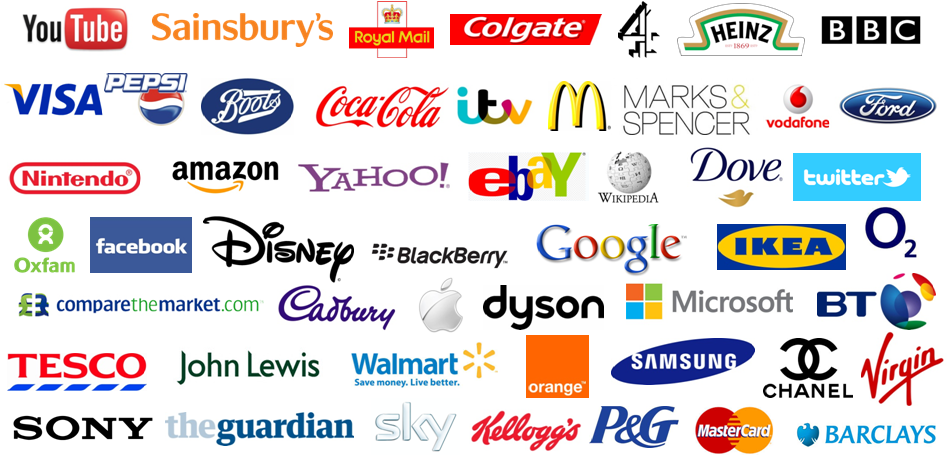

In [1]:
#from google.colab import drive
#drive.mount('/content/drive')

In [2]:
import pandas as pd 
import numpy as np
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [3]:
df = pd.read_csv('companies_sorted.csv')
df
#reading data to variable df

,Unnamed: 0,name,domain,year founded,industry,size range,locality,country,linkedin url,current employee estimate,total employee estimate
0,5872184,ibm,ibm.com,1911.0,information technology and services,10001+,"new york, new york, united states",united states,linkedin.com/company/ibm,274047,716906
1,4425416,tata consultancy services,tcs.com,1968.0,information technology and services,10001+,"bombay, maharashtra, india",india,linkedin.com/company/tata-consultancy-services,190771,341369
2,21074,accenture,accenture.com,1989.0,information technology and services,10001+,"dublin, dublin, ireland",ireland,linkedin.com/company/accenture,190689,455768
3,2309813,us army,goarmy.com,1800.0,military,10001+,"alexandria, virginia, united states",united states,linkedin.com/company/us-army,162163,445958
4,1558607,ey,ey.com,1989.0,accounting,10001+,"london, greater london, united kingdom",united kingdom,linkedin.com/company/ernstandyoung,158363,428960
...,...,...,...,...,...,...,...,...,...,...,...
7173421,1494427,certiport vouchers,certiportvouchers.com,2011.0,information technology and services,1 - 10,NaN,NaN,linkedin.com/company/certiport-vouchers,0,1
7173422,1494429,black tiger fight club,blacktigerclub.com,2006.0,"health, wellness and fitness",1 - 10,"peking, beijing, china",china,linkedin.com/company/black-tiger-club-hero,0,6
7173423,4768462,catholic bishop of chicago,NaN,NaN,religious institutions,1 - 10,"inverness, illinois, united states",united states,linkedin.com/company/catholic-bishop-of-chicago,0,1
7173424,1494436,medexo robotics ltd,NaN,NaN,research,1 - 10,"london, london, united kingdom",united kingdom,linkedin.com/company/medexo-robotics-ltd,0,2


# Choosing the necessary features
1.name 
2.industry 
3.country 
4.size range
5.current employee estimated
6.total employee estimated 
7.year founded

In [4]:
df = df[['name','industry','country','size range','current employee estimate','total employee estimate','year founded']]
df.head() 

,name,industry,country,size range,current employee estimate,total employee estimate,year founded
0,ibm,information technology and services,united states,10001+,274047,716906,1911.0
1,tata consultancy services,information technology and services,india,10001+,190771,341369,1968.0
2,accenture,information technology and services,ireland,10001+,190689,455768,1989.0
3,us army,military,united states,10001+,162163,445958,1800.0
4,ey,accounting,united kingdom,10001+,158363,428960,1989.0


In [5]:
df.info()
#info function discribes Dtypes of the particular feature

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7173426 entries, 0 to 7173425
Data columns (total 7 columns):
 #   Column                     Dtype  
---  ------                     -----  
 0   name                       object 
 1   industry                   object 
 2   country                    object 
 3   size range                 object 
 4   current employee estimate  int64  
 5   total employee estimate    int64  
 6   year founded               float64
dtypes: float64(1), int64(2), object(4)
memory usage: 383.1+ MB


In [6]:
df.describe()
#describe function only returns the count,mean,std, of numerical feature

,current employee estimate,total employee estimate,year founded
count,7.173426e+06,7.173426e+06,3.566446e+06
mean,1.387121e+01,3.225438e+01,2.001747e+03
std,3.545919e+02,8.741556e+02,2.096627e+01
min,0.000000e+00,1.000000e+00,1.451000e+03
25%,1.000000e+00,1.000000e+00,1.999000e+03
50%,1.000000e+00,2.000000e+00,2.009000e+03
75%,4.000000e+00,7.000000e+00,2.013000e+03
max,2.740470e+05,7.169060e+05,2.103000e+03


# Checking the missing values

In [7]:
df.isnull().sum()
#isnull function will return if the features are null(empty)in boolean(True or False)
#sum() will return no of counts.

name                               3
industry                      290003
country                      2349207
size range                         0
current employee estimate          0
total employee estimate            0
year founded                 3606980
dtype: int64

Calculating the percentage of missing values

In [8]:
#df.isnull().mean() 
#or 
pd.set_option('display.max_rows',10)
#set_option will let us to decide, display,max_rows,'10' can choose no of rows i want to see
df.isnull().mean().sort_values()
#sort_values sort it in ascending order

size range                   0.000000e+00
current employee estimate    0.000000e+00
total employee estimate      0.000000e+00
name                         4.182102e-07
industry                     4.042741e-02
country                      3.274875e-01
year founded                 5.028253e-01
dtype: float64

In [9]:
def drop_duplicates(df):
    old = df.shape[0]
    df.drop_duplicates(inplace=True)
    new = df.shape[0]
    count = old - new
    if (count == 0):
        print("No duplicate rows were found.")
    else:
        print(f"{count} duplicate rows were found and removed.")
#user-defined function for finding and removing duplicate values, as well as displaying the count

In [10]:
drop_duplicates(df)

828 duplicate rows were found and removed.


/var/folders/p9/wv3jwcsd19x8pf3r2kfnj0580000gn/T/ipykernel_62892/2148154982.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop_duplicates(inplace=True)


# Beautiful function that will help us in understanding the missing values in the dataset

<AxesSubplot:>

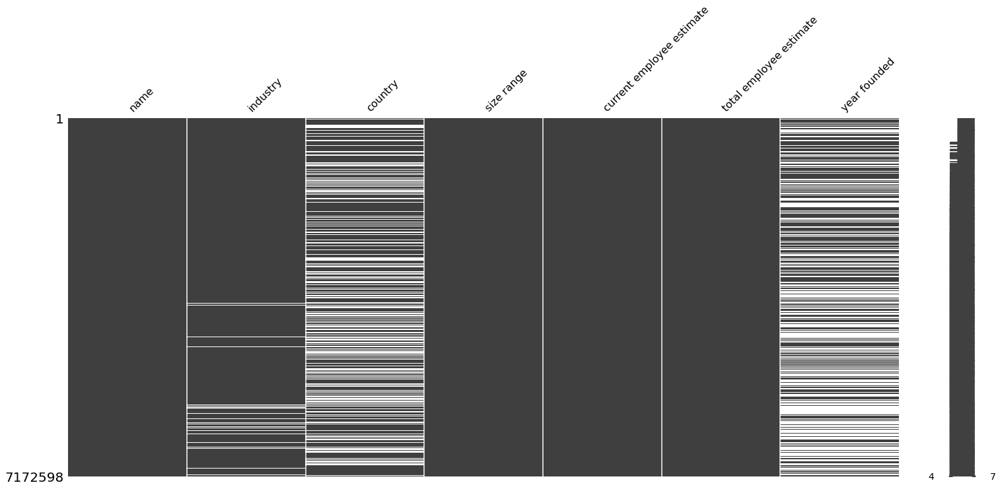

In [11]:
import missingno as mn# its a 
mn.matrix(df)

In [12]:
import warnings
from pandas.core.common import SettingWithCopyWarning
warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)

In [13]:
df['country'].fillna('missing',inplace = True) 
#filling the Null values with missing country
df['industry'].fillna('missing',inplace = True)
#filling the Null values with missing industry

In [14]:
df.isna().sum()
#again checking the missing values

name                               3
industry                           0
country                            0
size range                         0
current employee estimate          0
total employee estimate            0
year founded                 3606416
dtype: int64

In [15]:
df['name'].fillna('Unknown',inplace = True)
#filling the na values with Unknown

In [16]:
import matplotlib.pyplot as plt
import seaborn as sns
#importing the necessary libraries for graph plotting

In [17]:
df['year founded'].describe()
#figuring how to handing missing values in year founded

count    3.566182e+06
mean     2.001746e+03
std      2.096663e+01
min      1.451000e+03
25%      1.999000e+03
50%      2.009000e+03
75%      2.013000e+03
max      2.103000e+03
Name: year founded, dtype: float64

In [18]:
df['year founded'].mean()

2001.7463059933564

In [19]:
df['year founded'].median()

2009.0

In [20]:
df['year founded'].mode()

0    2015.0
Name: year founded, dtype: float64

<AxesSubplot:xlabel='year founded', ylabel='Density'>

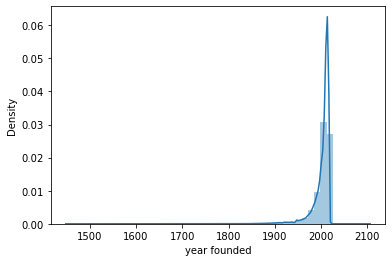

In [21]:
sns.distplot(df['year founded'])
#distplot helped us in determining the best method for dealing with missing values.

In [22]:
df.fillna(df['year founded'].median(),inplace=True)
#median holds good in this case so filling na values with median

<AxesSubplot:>

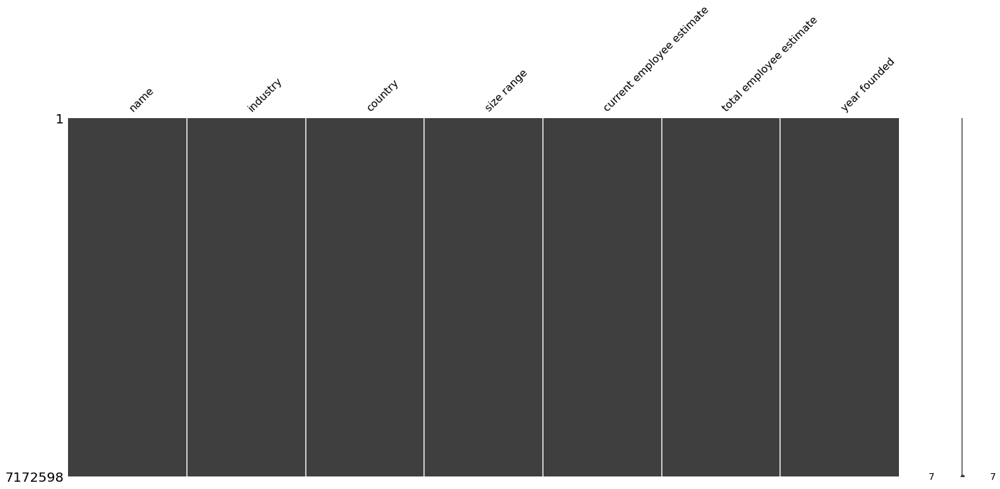

In [23]:
mn.matrix(df)
#again checking the missing values in dataset(there is no missing values, now we are good to analyse)

# Data Visualization

Text(0, 0.5, 'Current & total employee')

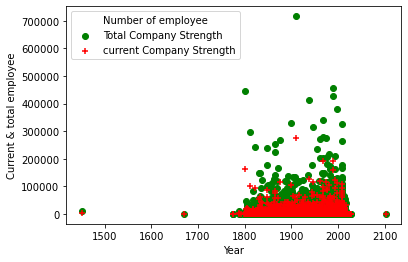

In [24]:
plt.scatter(x= 'year founded',y='total employee estimate',data=df,c='g',label='Total Company Strength')
plt.scatter(x= 'year founded',y='current employee estimate',data=df,c='r',marker='+',label='current Company Strength')
plt.legend(title='Number of employee')
plt.xlabel('Year')
plt.ylabel('Current & total employee')

The graph above depicts the total employee estimate as well as the current employee estimate.

<AxesSubplot:ylabel='Frequency'>

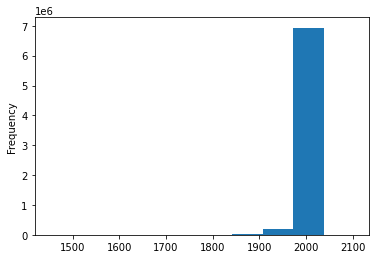

In [25]:
plt.figure
df['year founded'].plot(kind='hist')

The graph above shows that the majority of the companies were founded between 1920 and 2021.

<AxesSubplot:>

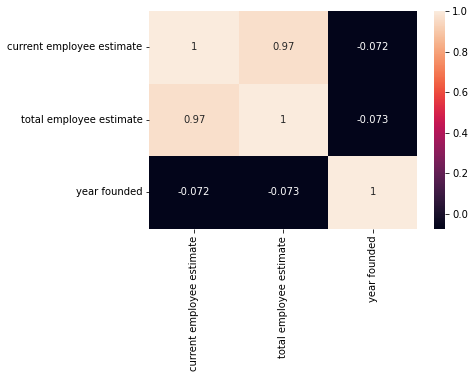

In [26]:
cor=df.corr()
#To find the pairwise correlation of all columns in the Pandas Dataframe in Python.

sns.heatmap(cor,xticklabels=cor.columns,yticklabels=cor.columns,annot=True)
#To find both linear and nonlinear relationships between variables.

In [27]:
df[df['country']=='india']
#displaying all indian companies

,name,industry,country,size range,current employee estimate,total employee estimate,year founded
1,tata consultancy services,information technology and services,india,10001+,190771,341369,1968.0
13,infosys,information technology and services,india,10001+,104752,215718,1981.0
26,wipro technologies,information technology and services,india,10001+,78261,177368,1945.0
44,hcl technologies,information technology and services,india,10001+,59993,127468,1991.0
84,tech mahindra,information technology and services,india,10001+,38631,81583,1986.0
...,...,...,...,...,...,...,...
7173085,inodai waldorf school - india,education management,india,1 - 10,0,1,2009.0
7173100,art infosystems pvt ltd,information technology and services,india,1 - 10,0,2,2009.0
7173177,data solution provider,computer software,india,1 - 10,0,4,2009.0
7173330,ginni tea,food & beverages,india,1 - 10,0,1,2009.0


In [28]:
df[df['country']=='india'].shape
#1,44,439 are Indian companies

(144439, 7)

In [29]:
df[df['country']=='india']
#displaying all indian companies

,name,industry,country,size range,current employee estimate,total employee estimate,year founded
1,tata consultancy services,information technology and services,india,10001+,190771,341369,1968.0
13,infosys,information technology and services,india,10001+,104752,215718,1981.0
26,wipro technologies,information technology and services,india,10001+,78261,177368,1945.0
44,hcl technologies,information technology and services,india,10001+,59993,127468,1991.0
84,tech mahindra,information technology and services,india,10001+,38631,81583,1986.0
...,...,...,...,...,...,...,...
7173085,inodai waldorf school - india,education management,india,1 - 10,0,1,2009.0
7173100,art infosystems pvt ltd,information technology and services,india,1 - 10,0,2,2009.0
7173177,data solution provider,computer software,india,1 - 10,0,4,2009.0
7173330,ginni tea,food & beverages,india,1 - 10,0,1,2009.0


In [30]:
df[df['year founded']>=2015]
#displaying companies that were founded in 2015 or later

,name,industry,country,size range,current employee estimate,total employee estimate,year founded
123,dxc technology,information technology and services,united states,10001+,31671,39585,2017.0
214,thales,defense & space,united states,10001+,20983,54041,2015.0
218,iqvia,hospital & health care,united states,10001+,20957,44812,2016.0
277,lafargeholcim,building materials,switzerland,10001+,17859,34272,2015.0
336,upwork,internet,united states,10001+,15693,20194,2015.0
...,...,...,...,...,...,...,...
7173266,game slate,publishing,united states,1 - 10,0,2,2016.0
7173349,anwar real estate inc.,real estate,missing,1 - 10,0,1,2015.0
7173369,winove,wine and spirits,portugal,1 - 10,0,2,2015.0
7173402,woonartikel.nl,online media,netherlands,1 - 10,0,1,2015.0


In [31]:
df[df['year founded']<1900]
#displaying companies that were founded before 1900 

,name,industry,country,size range,current employee estimate,total employee estimate,year founded
3,us army,military,united states,10001+,162163,445958,1800.0
9,at&t,telecommunications,united states,10001+,115188,269659,1876.0
15,citi,financial services,united states,10001+,101482,298171,1812.0
17,jpmorgan chase & co.,financial services,united states,10001+,95234,242135,1823.0
21,siemens,electrical/electronic manufacturing,germany,10001+,87381,240528,1847.0
...,...,...,...,...,...,...,...
7166264,athletics northern territory,sports,missing,1 - 10,0,5,1891.0
7166941,griffin stringer ltd,environmental services,united kingdom,1 - 10,0,1,1836.0
7168246,institut archéologique du luxembourg asbl,government administration,belgium,1 - 10,0,1,1847.0
7170784,advokatfirmaet lars meilvang,legal services,denmark,1 - 10,0,1,1899.0


In [32]:
sort = sorted(set(df.industry.tolist()))
sort
#return all the distinct industries in a sorted order

['accounting',
 'airlines/aviation',
 'alternative dispute resolution',
 'alternative medicine',
 'animation',
 'apparel & fashion',
 'architecture & planning',
 'arts and crafts',
 'automotive',
 'aviation & aerospace',
 'banking',
 'biotechnology',
 'broadcast media',
 'building materials',
 'business supplies and equipment',
 'capital markets',
 'chemicals',
 'civic & social organization',
 'civil engineering',
 'commercial real estate',
 'computer & network security',
 'computer games',
 'computer hardware',
 'computer networking',
 'computer software',
 'construction',
 'consumer electronics',
 'consumer goods',
 'consumer services',
 'cosmetics',
 'dairy',
 'defense & space',
 'design',
 'e-learning',
 'education management',
 'electrical/electronic manufacturing',
 'entertainment',
 'environmental services',
 'events services',
 'executive office',
 'facilities services',
 'farming',
 'financial services',
 'fine art',
 'fishery',
 'food & beverages',
 'food production',
 'fund-

In [33]:
df['industry'].nunique()
#will return no of unique industry

149

In [34]:
IT_industries = [
 'animation',
 'biotechnology',
 'computer & network security',
 'computer games',
 'computer hardware',
 'computer networking',
 'computer software',
 'consumer electronics',
 'defense & space',
 'e-learning',
 'industrial automation',
 'information services',
 'information technology and services',
 'internet',
 'mechanical or industrial engineering',
 'program development',
 'telecommunications',
 'wireless'
]
#grouped all domains under IT industry

In [35]:
Top_it = df[df.industry.isin(IT_industries)]
#The domains listed in IT industries are checked in the industry column.

In [36]:
it_cities = Top_it[df.country != 'missing'].country.value_counts(normalize=True).sort_values(ascending=False)\
            .reset_index().rename(columns={'index':'country_city','country': 'Company_count'})
it_cities.head(10)
#removing the country name missing 
#counting the country and sorting
#renaming 


/var/folders/p9/wv3jwcsd19x8pf3r2kfnj0580000gn/T/ipykernel_62892/617132183.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  it_cities = Top_it[df.country != 'missing'].country.value_counts(normalize=True).sort_values(ascending=False)\


,country_city,Company_count
0,united states,0.373955
1,united kingdom,0.089612
2,india,0.056632
3,canada,0.037975
4,spain,0.037179
5,france,0.030554
6,brazil,0.030110
7,germany,0.028559
8,netherlands,0.028166
9,italy,0.028036


Top 10 IT companies by country and city

In [37]:
sports=df[df['industry']=='sports']
sports
#displaying the sports industry

,name,industry,country,size range,current employee estimate,total employee estimate,year founded
2026,nothing,sports,missing,10001+,4243,5181,2009.0
4273,columbia sportswear,sports,united states,1001 - 5000,2370,6095,1938.0
4638,img,sports,united states,1001 - 5000,2202,9909,1960.0
4822,padi,sports,united states,1001 - 5000,2132,3443,1966.0
5078,fc barcelona,sports,spain,5001 - 10000,2036,3310,1899.0
...,...,...,...,...,...,...,...
7172831,fc preussen hameln 07,sports,germany,1 - 10,0,1,2009.0
7172844,surestream football academy ltd,sports,united kingdom,1 - 10,0,1,2009.0
7172863,club de golf costa dorada,sports,missing,1 - 10,0,4,2009.0
7173118,morris county youth soccer association,sports,united states,1 - 10,0,3,2009.0


In [38]:
indust = df['industry'].value_counts().rename_axis('industry').reset_index(name='Company_count')
indust.head(10)
#Industry and company_count

,industry,Company_count
0,information technology and services,452995
1,marketing and advertising,338110
2,missing,289846
3,construction,257881
4,management consulting,194540
5,real estate,193437
6,computer software,191252
7,internet,172199
8,financial services,170850
9,"health, wellness and fitness",145642


In [39]:
indust = df['industry'].value_counts(normalize=True).rename_axis('industry').reset_index(name='Company_count')
indust

,industry,Company_count
0,information technology and services,0.063156
1,marketing and advertising,0.047139
2,missing,0.040410
3,construction,0.035954
4,management consulting,0.027123
...,...,...
144,fishery,0.000328
145,ranching,0.000324
146,railroad manufacture,0.000253
147,tobacco,0.000189


In [40]:
indust.shape

(149, 2)

# Better way of understanding the dataset by Pandas Profiling

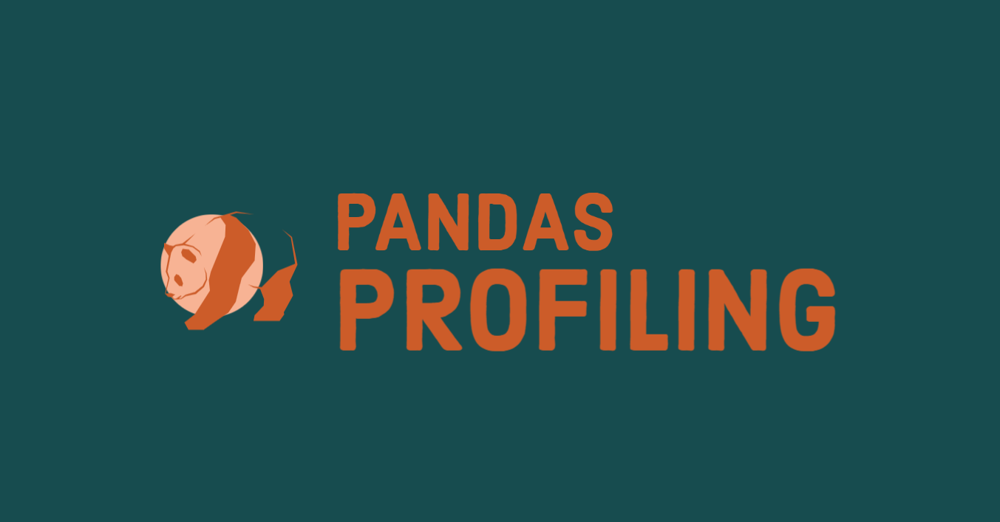

Pandas profiling is an open source Python module with which we can quickly do an exploratory data analysis with just a few lines of code. Besides, if this is not enough to convince us to use this tool, it also generates interactive reports in web format that can be presented to any person, even if they don’t know programming.

In short, what pandas profiling does is save us all the work of visualizing and understanding the distribution of each variable. It generates a report with all the information easily available.



In [41]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Autoviz: Automatically Visualize any Dataset

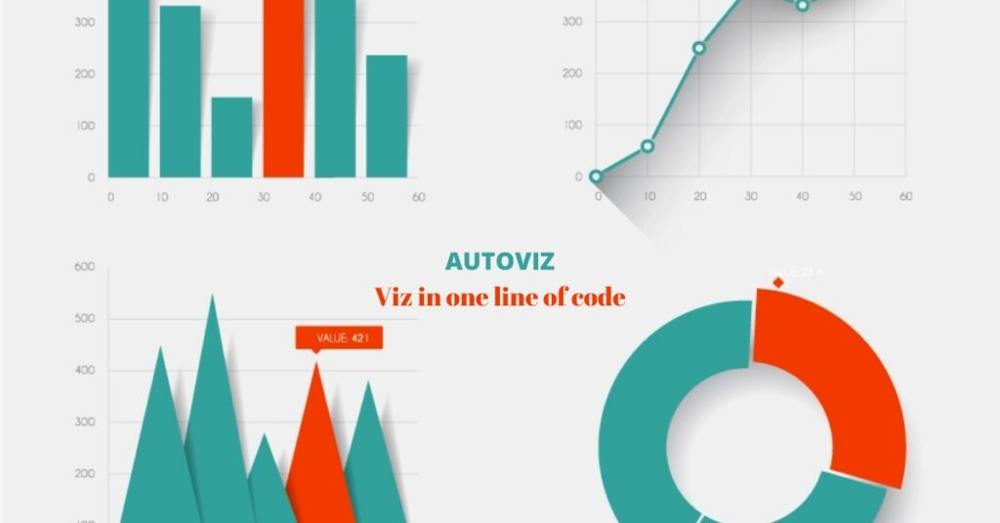

AutoViz performs automatic visualization of any dataset with just one line of code. AutoViz can find the most important features and plot impactful visualizations only using those automatically selected features. Also, AutoViz is incredibly fast so it creates visualization within seconds.

Imported v0.1.55. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
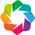

    max_rows_analyzed is smaller than dataset shape 7173426...
        randomly sampled 150000 rows from read CSV file
Shape of your Data Set loaded: (150000, 11)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...


,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
Unnamed: 0,10000,int64,0,0.000000,100.000000,0,possible ID column: drop
name,10000,object,0,0.000000,100.000000,1,"combine rare categories, possible ID column: drop"
linkedin url,10000,object,0,0.000000,100.000000,1,"combine rare categories, possible ID column: drop"
domain,7755,object,2245,22.450000,77.550000,1,"combine rare categories, fill missing values, fix mixed data types"
locality,3186,object,3560,35.600000,31.860000,1,"combine rare categories, fill missing values, fix mixed data types"
total employee estimate,340,int64,0,0.000000,3.400000,0,
current employee estimate,229,int64,0,0.000000,2.290000,0,
industry,147,object,400,4.000000,1.470000,2,"combine rare categories, fill missing values, fix mixed data types"
year founded,144,float64,5000,50.000000,1.440000,0,"fill missing values, skewed column: cap or drop possible outliers"
country,126,object,3319,33.190000,1.260000,1,"combine rare categories, fill missing values, fix mixed data types"


    11 Predictors classified...
        1 variables removed since they were ID or low-information variables
        List of variables removed: ['Unnamed: 0']
Since Number of Rows in data 150000 exceeds maximum, randomly sampling 150000 rows for EDA...


[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to
[nltk_data]    |     /Users/shreyanthhg/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to
[nltk_data]    |     /Users/shreyanthhg/nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to
[nltk_data]    |     /Users/shreyanthhg/nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to
[nltk_data]    |     /Users/shreyanthhg/nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to
[nltk_data]    |     /Users/shreyanthhg/nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /Users/shreyanthhg/nltk_data...
[nltk_data]    |   Pa

All Plots done
Time to run AutoViz = 181 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


,Unnamed: 0,name,domain,year founded,industry,size range,locality,country,linkedin url,current employee estimate,total employee estimate
1712978,2845651,valeo networks inc.,valeonetworks.com,NaN,information technology and services,1 - 10,"scottsdale, arizona, united states",united states,linkedin.com/company/valeo-networks-inc-,4,6
1125233,2315190,u5 marketing - bureau de arte,u5marketing.com.br,2011.0,marketing and advertising,11 - 50,"sao paulo, sao paulo, brazil",brazil,linkedin.com/company/u5-marketing---bureau-de-criação,7,14
2763274,683115,star custom framers,selectsportswear.com,NaN,consumer services,1 - 10,NaN,NaN,linkedin.com/company/star-custom-framers,2,2
6747208,2011695,git hydros consult gmbh,hydrosconsult.de,2001.0,information technology and services,1 - 10,NaN,NaN,linkedin.com/company/git-hydros-consult-gmbh,0,1
2587339,3082914,receptorpharma,NaN,NaN,pharmaceuticals,1 - 10,NaN,NaN,linkedin.com/company/receptorpharma,2,2
...,...,...,...,...,...,...,...,...,...,...,...
6439775,1899698,naked jobs,nakedgenerations.com,2009.0,staffing and recruiting,1 - 10,"london, greater london, united kingdom",united kingdom,linkedin.com/company/naked-jobs,0,1
3217897,2074113,sites security,sites.ua,NaN,security and investigations,1 - 10,NaN,NaN,linkedin.com/company/sites-security,2,5
12995,2508743,buscando recolocacao,eloead.com.br,NaN,capital markets,1001 - 5000,NaN,NaN,linkedin.com/company/buscando-recolocacao,876,1112
3283722,4588874,exclusive assistant group,askeag.com,2010.0,management consulting,1 - 10,"miami, florida, united states",united states,linkedin.com/company/exclusive-assistant-group,1,1


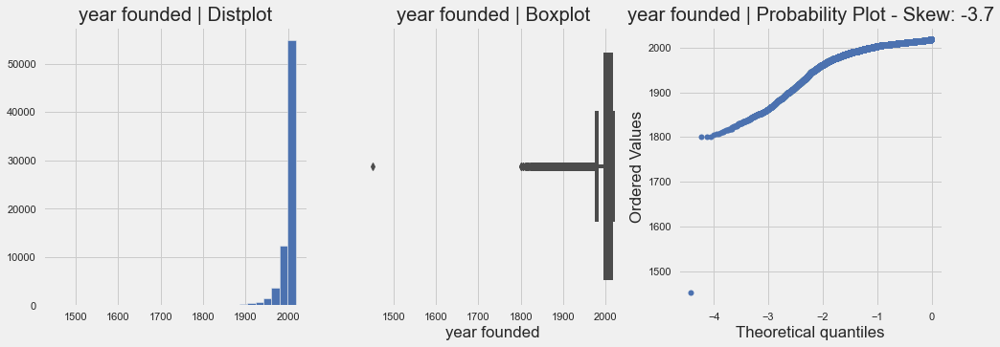

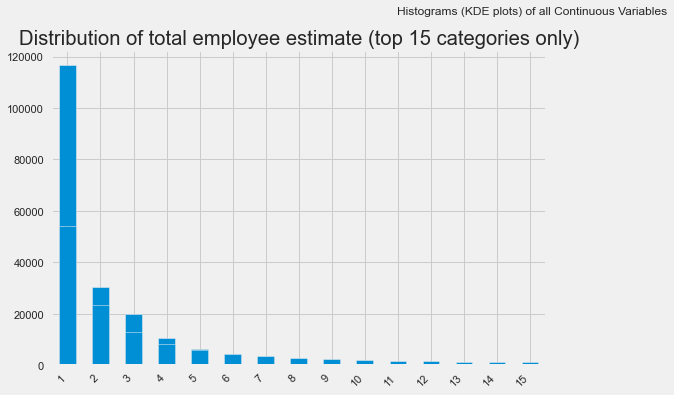

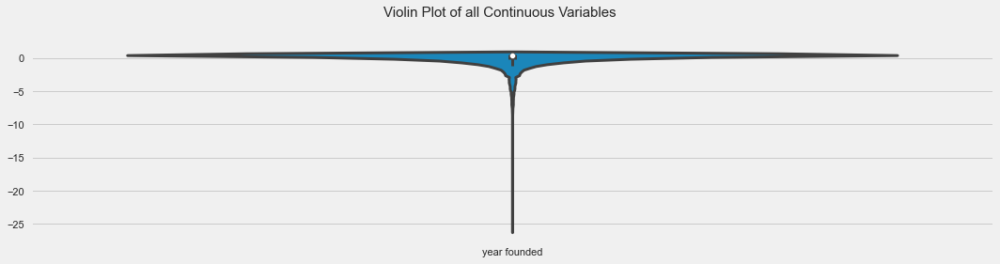

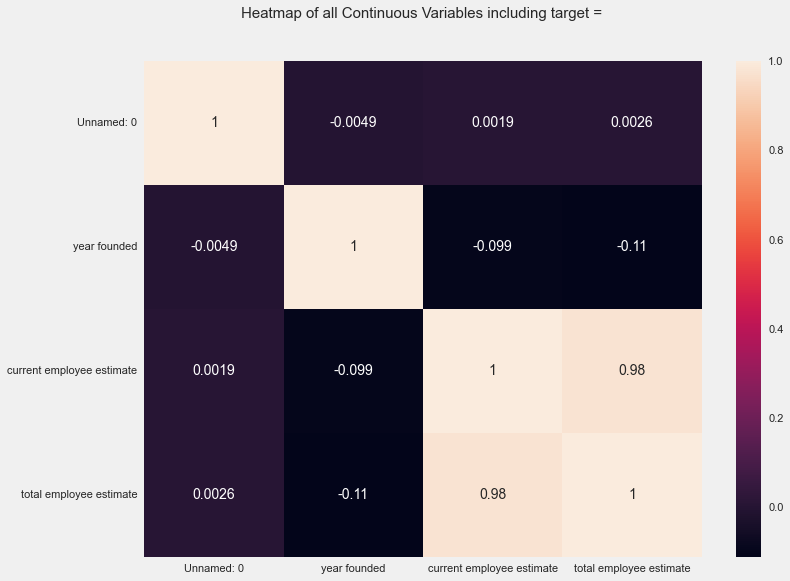

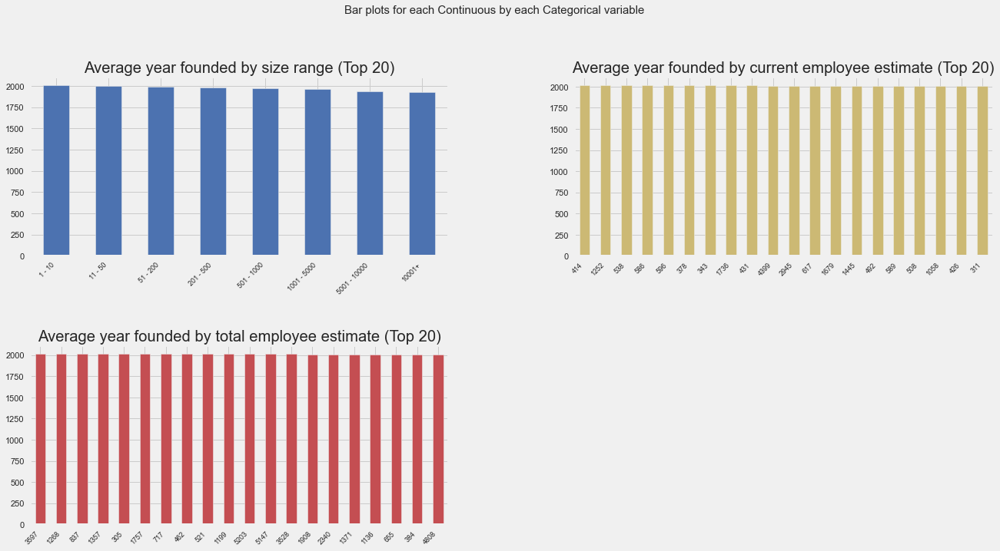

...

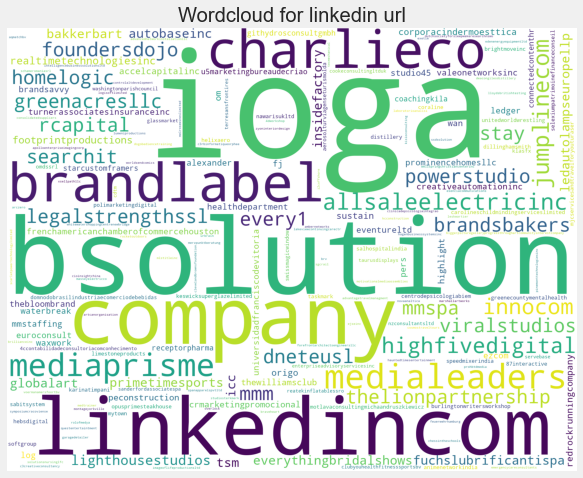

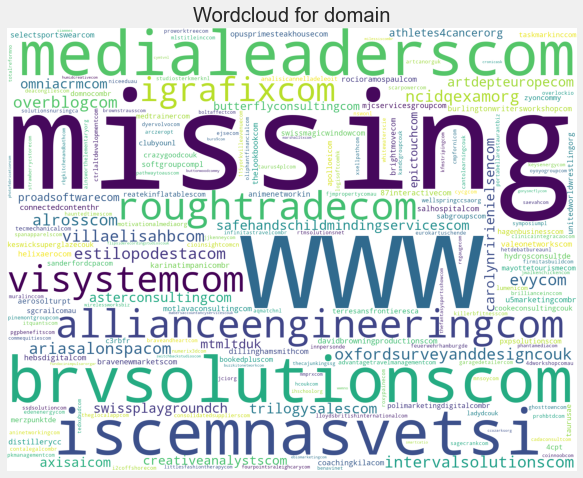

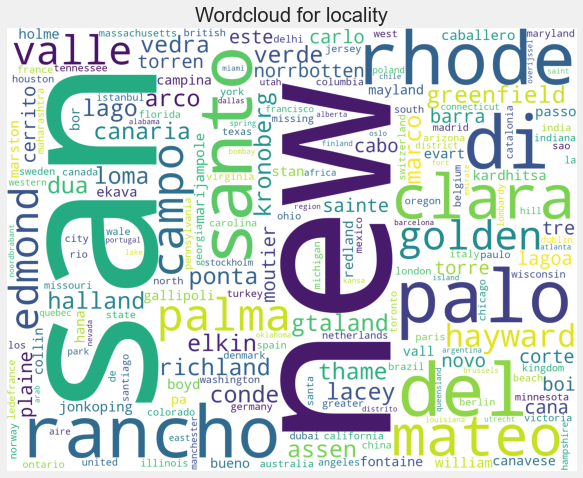

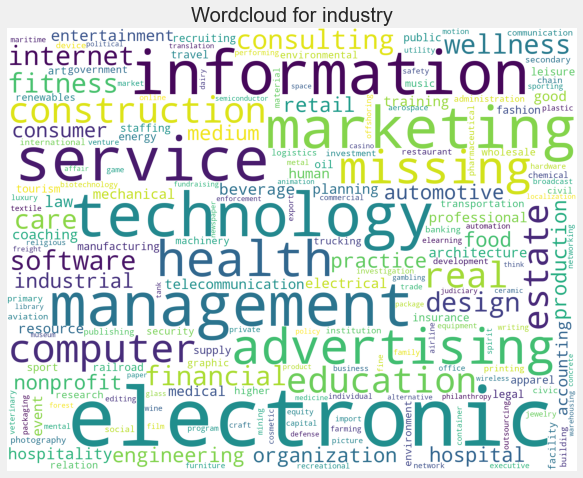

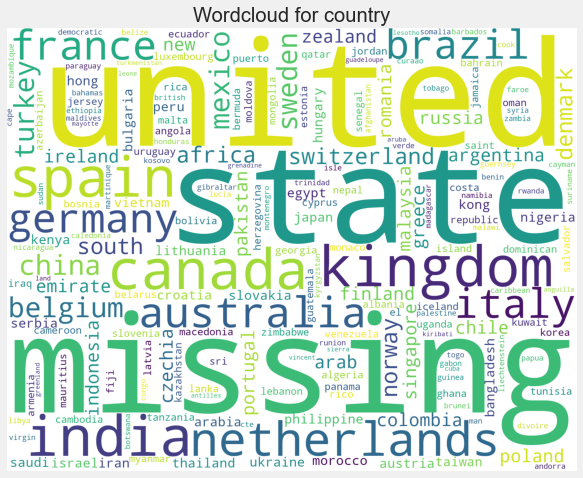

In [42]:
#importing Autoviz class
from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()
report = AV.AutoViz('companies_sorted.csv')
report

# Conclusion


1.	'United States', 'United Kingdom', 'Canada', 'India', and ‘Spain’ are top 5 countries with the highest number of companies.
2.	It shows that majority of the companies were founded between 1920 to 2021.
3.	There are 1,44,439 Indian companies.
4.	In total of 71,72,598 in the world 6,04,166 companies where founded after 2015 will covers 8% of total list.
5.	There were 30k company which was established before 1900. Which includes Us army, JPMorgan chase & co., athletics northern territory, city of Grenada.
6.	149 different types industries are present, which includes, Information technology and services (.06%), marketing and advertising (.04), construction (.04%), management consulting (.02).
7.	United States has 37% of companies, where has India .05 % of companies.
